In [8]:
#Loading Relevant Libraries
install.packages("kknn")
library(kknn)
install.packages("themis")
library(themis)
library(tidyverse)
library(tidymodels)
library(repr)
library(RColorBrewer)
install.packages("GGally")
library(GGally)
install.packages("ISLR")
library(ISLR)

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

also installing the dependencies ‘RANN’, ‘ROSE’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Loading required package: recipes

Loading required package: dplyr


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘recipes’


The following object is masked from ‘package:stats’:

    step


── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.2     ✔ purrr   1.0.1
✔ tibble  3.2.1     ✔ stringr 1.5.0
✔ tidyr   1.3.0     ✔ forcats 0.5.2
✔ readr   2.1.3     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter()  masks stats::filter()
✖ stringr::fixed() masks recipes::fixed()
✖ dplyr::lag()     masks stats::lag()
── Attachi

In [10]:
set.seed(1000) 
#Reading in the Water Potability Dataset
url <- "https://raw.githubusercontent.com/chililw/dsci_group_project_027/main/water_potability.csv"
water_pot_data <- read_csv(url)

#Looking at the head of the data
head(water_pot_data)

Rows: 3276 Columns: 10
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
dbl (10): ph, Hardness, Solids, Chloramines, Sulfate, Conductivity, Organic_...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NA,204.8905,20791.32,7.300212,368.5164,564.3087,10.379783,86.99097,2.963135,0
3.716080,129.4229,18630.06,6.635246,NA,592.8854,15.180013,56.32908,4.500656,0
8.099124,224.2363,19909.54,9.275884,NA,418.6062,16.868637,66.42009,3.055934,0
8.316766,214.3734,22018.42,8.059332,356.8861,363.2665,18.436524,100.34167,4.628771,0
9.092223,181.1015,17978.99,6.546600,310.1357,398.4108,11.558279,31.99799,4.075075,0
5.584087,188.3133,28748.69,7.544869,326.6784,280.4679,8.399735,54.91786,2.559708,0


*Table 1: Head of the original dataset*

In [11]:
#Factor Recoding Potability
water_pot_cleaned <- water_pot_data |>
    mutate(Potability = as_factor(Potability)) |>
    mutate(Potability = fct_recode(Potability, "Potable" = "1", "Unpotable" = "0"))

#Dropping Missing Values from the Dataset
water_pot_cleaned <- water_pot_cleaned |>
    drop_na()

#Looking at the head of the factor recoded data
head(water_pot_cleaned)

ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
8.316766,214.3734,22018.42,8.059332,356.8861,363.2665,18.436524,100.34167,4.628771,Unpotable
9.092223,181.1015,17978.99,6.546600,310.1357,398.4108,11.558279,31.99799,4.075075,Unpotable
5.584087,188.3133,28748.69,7.544869,326.6784,280.4679,8.399735,54.91786,2.559708,Unpotable
10.223862,248.0717,28749.72,7.513408,393.6634,283.6516,13.789695,84.60356,2.672989,Unpotable
8.635849,203.3615,13672.09,4.563009,303.3098,474.6076,12.363817,62.79831,4.401425,Unpotable
11.180284,227.2315,25484.51,9.077200,404.0416,563.8855,17.927806,71.97660,4.370562,Unpotable


*Table 2: Head of the cleaned dataset*

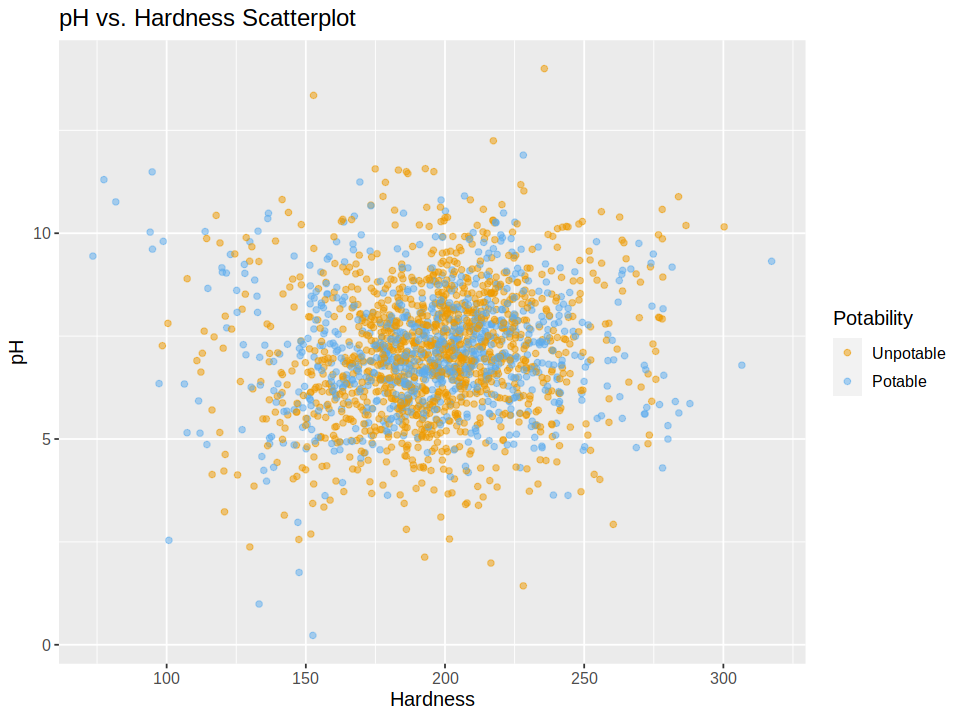

In [12]:
set.seed(1000) 
options(repr.plot.width = 8, repr.plot.height = 6)

#Visualizing two predictor variables to illustrate synthetically generated data
water_pot_pred_plot <- water_pot_cleaned |>
  ggplot(aes(x = Hardness, y = ph, color = Potability)) +
  geom_point(alpha = 0.5) +
  labs(color = "Potability") +
  scale_color_manual(values = c("orange2", "steelblue2")) + 
  ylab("pH") +
  ggtitle("pH vs. Hardness Scatterplot") +
  theme(text = element_text(size = 12))

water_pot_pred_plot    

*Figure 1: pH vs. Hardness scatterplot - coloured by Potability*

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


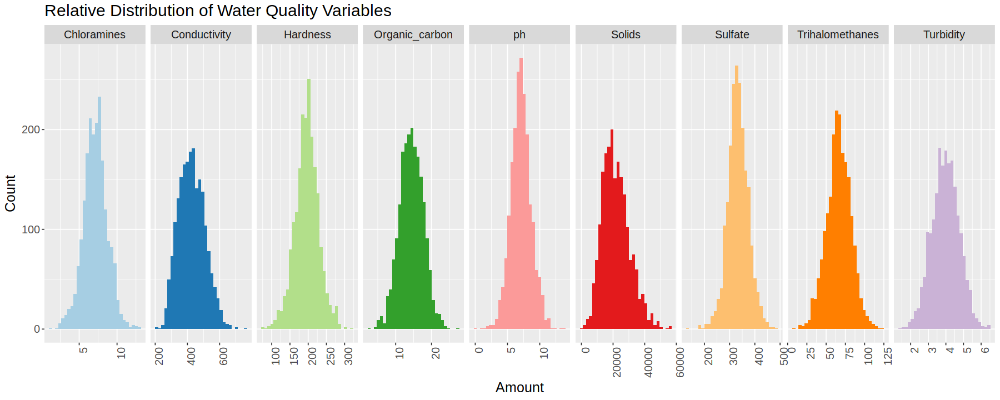

In [13]:
set.seed(1000) 
options(repr.plot.width = 15, repr.plot.height = 6)

#Visualizing normal distribution of all variables, another indicator of synthetic data
modified_water <- water_pot_cleaned |>
    select(-Potability) |>
    pivot_longer(cols = ph:Turbidity,
                 names_to = "Characteristic",
                 values_to = "Concentration")

water_vis <- ggplot(modified_water, aes(x = Concentration, fill = Characteristic)) + 
    geom_histogram() + 
    facet_grid(cols = vars(Characteristic), scales = "free")+
    xlab("Amount")+
    ylab("Count")+ 
    ggtitle("Relative Distribution of Water Quality Variables") +
    theme(axis.text.x = element_text(angle = 90, hjust = 1),
         strip.text.y.left = element_text(angle = 0),
         text = element_text(size = 15),
         legend.position = "none") +
    scale_fill_brewer(palette = "Paired")

water_vis

*Figure 2: Relative distribution of water quality variables*

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


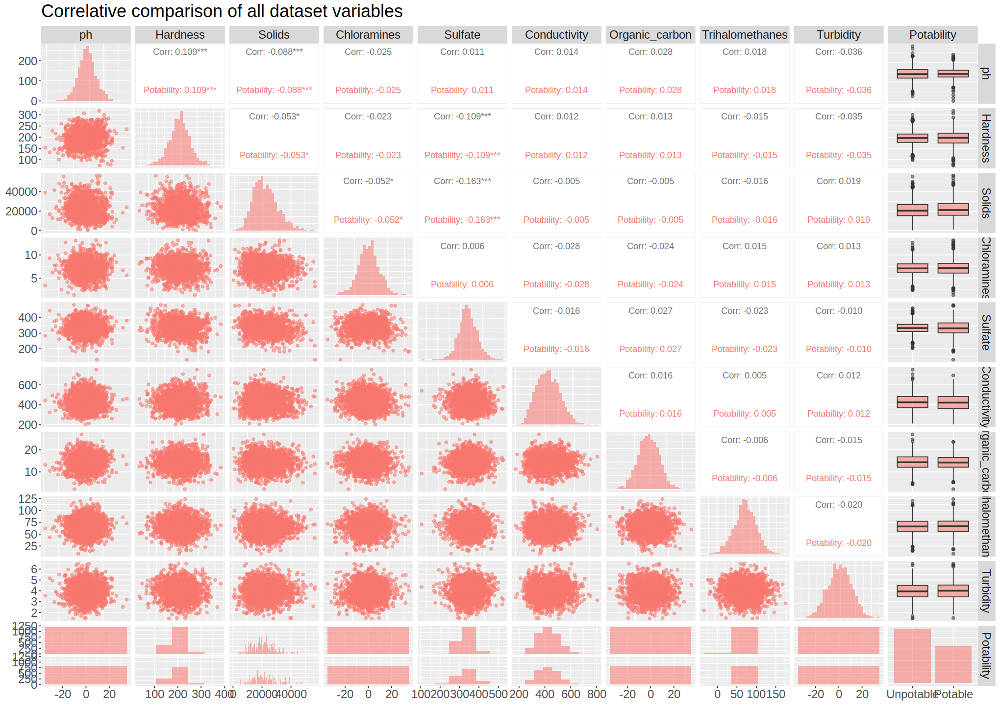

In [16]:
set.seed(1000) 
options(repr.plot.width = 17, repr.plot.height = 12)
#Using GGpairs to display the lack of correlation between potential predictor variables
water_pred_pairs <- water_pot_cleaned |>
     ggpairs(
         lower=list(combo=wrap("facethist",  binwidth = 70)),
         diag = list(continuous = "barDiag"),
         aes(color = "Potability", alpha = 0.4)
     ) +
     theme(text = element_text(size = 18)) +
     ggtitle("Correlative comparison of all dataset variables")

water_pred_pairs

*Figure 3: Correlative comparison of all dataset variables*

In [19]:
#Checking Counts of variables
water_pot_count <- water_pot_cleaned |>
    select(Potability) |>
    group_by(Potability) |>
    summarize(Count = n())
water_pot_count

Potability,Count
<fct>,<int>
Unpotable,1200
Potable,811


*Table 3: Counts of Potable and Unpotable rows*

In [20]:
set.seed(1000) 
#Rebalancing the Data
ups_recipe <- recipe(Potability ~., data = water_pot_cleaned) |>
  step_upsample(Potability, over_ratio = 1, skip = FALSE) |>
  prep()

#Looking at the recipe specifications
ups_recipe

upsampled_water <- bake(ups_recipe, water_pot_cleaned)

Recipe

Inputs:

      role #variables
   outcome          1
 predictor          9

Training data contained 2011 data points and no missing data.

Operations:

Up-sampling based on Potability [trained]

In [21]:
#Looking at rebalanced count of potability classifications
upsampled_count <- upsampled_water |>
  group_by(Potability) |>
  summarize(n = n())

upsampled_count

Potability,n
<fct>,<int>
Unpotable,1200
Potable,1200


*Table 4: Counts of Potable and Unpotable rows after rebalancing*

In [22]:
set.seed(1000) 

#Splitting the data into training and testing sets
water_split <- initial_split(upsampled_water, prop = 0.75, strata = Potability)
water_train <- training(water_split)
water_test <- testing(water_split)

In [23]:
set.seed(1000)

#Creating an object without the variable we are looking to predict
names <- colnames(water_train |> select(-Potability))

#Create an empty tibble to store the results
accuracies <- tibble(size = integer(), 
                     model_string = character(), 
                     accuracy = numeric())

In [24]:
set.seed(1000) 
#Create a model specification
water_tune <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("classification")

#Create a 5-fold cross-validation object
water_vfold <- vfold_cv(water_train, v = 5, strata = Potability)

#Store the total number of predictors
n_total <- length(names)

#Stores selected predictors
selected <- c()

In [25]:
set.seed(1000) 
#For every size from 1 to the total number of predictors
for (i in 1:n_total) {
    #For every predictor still not added yet
    accs <- list()
    models <- list()
    for (j in 1:length(names)) {
        #Create a model string for this combination of predictors
        preds_new <- c(selected, names[[j]])
        model_string <- paste("Potability", "~", paste(preds_new, collapse="+"))

        #Create a recipe from the model string
        water_recipe <- recipe(as.formula(model_string), 
                                data = water_train) |>
                          step_scale(all_predictors()) |>
                          step_center(all_predictors())

        #Tune the KNN classifier with these predictors, 
        #and collect the accuracy for the best K
        acc <- workflow() |>
          add_recipe(water_recipe) |>
          add_model(water_tune) |>
          tune_grid(resamples = water_vfold, grid = 10) |>
          collect_metrics() |>
          filter(.metric == "accuracy") |>
          summarize(mx = max(mean))
        acc <- acc$mx |> unlist()

        #Add this result to the dataframe
        accs[[j]] <- acc
        models[[j]] <- model_string
    }
    jstar <- which.max(unlist(accs))
    accuracies <- accuracies |> 
      add_row(size = i, 
              model_string = models[[jstar]], 
              accuracy = accs[[jstar]])
    selected <- c(selected, names[[jstar]])
    names <- names[-jstar]
}

accuracies

size,model_string,accuracy
<int>,<chr>,<dbl>
1,Potability ~ Chloramines,0.6983333
2,Potability ~ Chloramines+Sulfate,0.6988889
3,Potability ~ Chloramines+Sulfate+ph,0.7355556
4,Potability ~ Chloramines+Sulfate+ph+Hardness,0.7466667
5,Potability ~ Chloramines+Sulfate+ph+Hardness+Solids,0.7566667
6,Potability ~ Chloramines+Sulfate+ph+Hardness+Solids+Conductivity,0.7477778
7,Potability ~ Chloramines+Sulfate+ph+Hardness+Solids+Conductivity+Trihalomethanes,0.7572222
8,Potability ~ Chloramines+Sulfate+ph+Hardness+Solids+Conductivity+Trihalomethanes+Organic_carbon,0.7561111
9,Potability ~ Chloramines+Sulfate+ph+Hardness+Solids+Conductivity+Trihalomethanes+Organic_carbon+Turbidity,0.7505556


*Table 5: Results of ideal predictor accuracy analysis*

In [26]:
set.seed(1000) 

#Setting tuning specification for cross validation
water_tune <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("classification")

#Creating recipe using optimal predictors selected in the previous scell
water_recipe <- recipe(Potability ~ Chloramines + ph + Sulfate + Hardness + Solids, data = water_train) |>
    step_scale(all_predictors()) |>
    step_center(all_predictors())

In [27]:
set.seed(1000) 
#K Neighbor Testing sequence
k_vals <- tibble(neighbors = seq(from = 1, to = 75, by = 2))

#Number of folds
water_vfold <- vfold_cv(water_train, v = 5, strata = Potability)

#Results
knn_results <- workflow() |>
    add_recipe(water_recipe) |>
    add_model(water_tune) |>
    tune_grid(resamples = water_vfold, grid = k_vals) |>
    collect_metrics()

knn_results

neighbors,.metric,.estimator,mean,n,std_err,.config
<dbl>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
1,accuracy,binary,0.7566667,5,0.008810418,Preprocessor1_Model01
1,roc_auc,binary,0.7566667,5,0.008810418,Preprocessor1_Model01
3,accuracy,binary,0.6961111,5,0.014153044,Preprocessor1_Model02
3,roc_auc,binary,0.7561698,5,0.015300655,Preprocessor1_Model02
5,accuracy,binary,0.6861111,5,0.020126912,Preprocessor1_Model03
5,roc_auc,binary,0.7482901,5,0.017124723,Preprocessor1_Model03
7,accuracy,binary,0.6766667,5,0.014288690,Preprocessor1_Model04
7,roc_auc,binary,0.7394877,5,0.013254651,Preprocessor1_Model04
9,accuracy,binary,0.6733333,5,0.009362389,Preprocessor1_Model05


*Table 6: K Cross-Validation Accuracy Results*

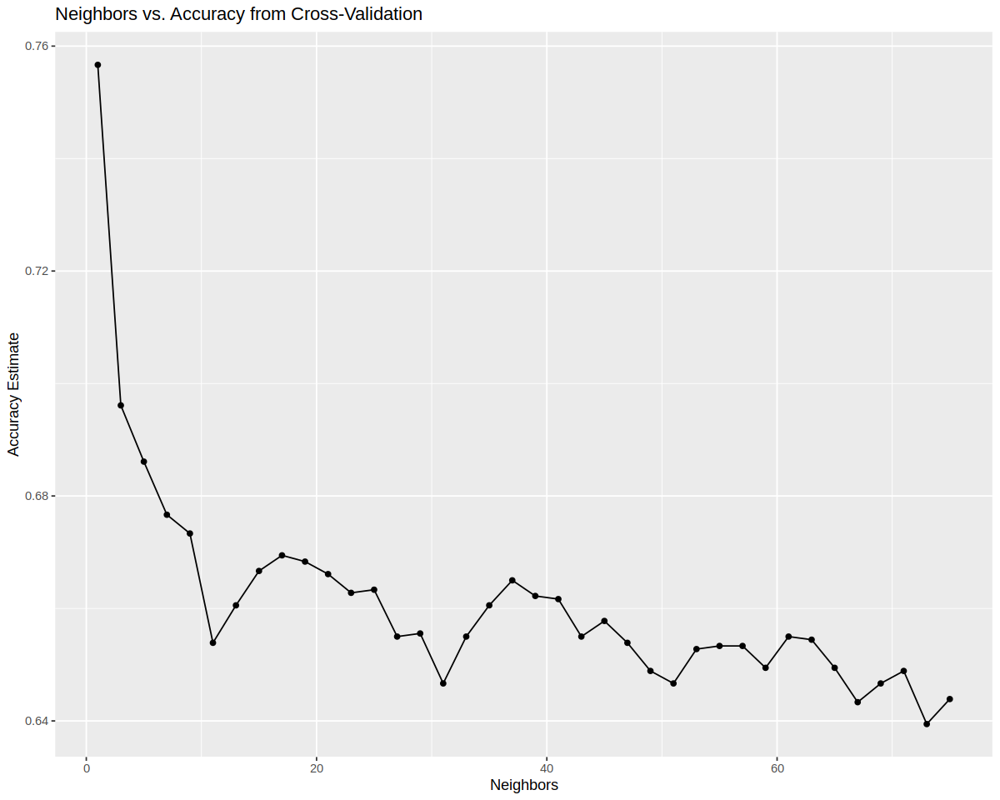

In [28]:
set.seed(1000) 
options(repr.plot.width = 10, repr.plot.height = 8)

#Comparing number of neighbours to results
comparison <- knn_results |>
    filter(.metric == "accuracy")

#Visualizing number of neighbours to accuracy
accuracy_versus_k <- ggplot(comparison, aes(x = neighbors, y = mean))+
       geom_point() +
       geom_line() +
       labs(x = "Neighbors", y = "Accuracy Estimate") +
       ggtitle("Neighbors vs. Accuracy from Cross-Validation")
accuracy_versus_k

#K Selection is between 1 and 24
#K Selection is 18

*Figure 4: Accuracy vs. Neighbors from cross-validation*

In [29]:
set.seed(1000) 
#Establishing model specifications with chosen K
water_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 18) |>
    set_engine("kknn") |>
    set_mode("classification")

#Creating the fit with our chosen predictors and k
knn_fit <- workflow() |>
       add_recipe(water_recipe) |>
       add_model(water_spec) |>
       fit(data = water_train) 

knn_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: nearest_neighbor()

── Preprocessor ────────────────────────────────────────────────────────────────
2 Recipe Steps

• step_scale()
• step_center()

── Model ───────────────────────────────────────────────────────────────────────

Call:
kknn::train.kknn(formula = ..y ~ ., data = data, ks = min_rows(18,     data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.3227778
Best kernel: rectangular
Best k: 18

In [30]:
set.seed(1000) 
#Table with predictions (".pred_class")
water_test_predictions <- predict(knn_fit, water_test) |>
  bind_cols(water_test)

head(water_test_predictions)

.pred_class,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
Potable,9.092223,181.1015,17978.99,6.546600,310.1357,398.4108,11.55828,31.99799,4.075075,Unpotable
Unpotable,8.635849,203.3615,13672.09,4.563009,303.3098,474.6076,12.36382,62.79831,4.401425,Unpotable
Potable,6.660212,168.2837,30944.36,5.858769,310.9309,523.6713,17.88424,77.04232,3.749701,Unpotable
Potable,6.514415,198.7674,21218.70,8.670937,323.5963,413.2905,14.90000,79.84784,5.200885,Unpotable
Unpotable,10.682966,173.3755,15758.74,5.570784,307.3526,323.8079,10.09087,78.47278,3.999775,Unpotable
Potable,9.147197,211.7141,11920.61,7.230795,339.7519,527.7089,18.27531,47.63488,3.794532,Unpotable


*Table 7: Head of test set predictions using K = 18*

In [31]:
set.seed(1000) 
#Accuracy of the model
water_test_predictions |>
  metrics(truth = Potability, estimate = .pred_class) |>
  filter(.metric == "accuracy")

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.6783333


*Table 8: Accuracy of the model on the test data*

In [32]:
set.seed(1000) 
#Confusion matrix of results
confusion <- water_test_predictions |>
             conf_mat(truth = Potability, estimate = .pred_class) 
confusion 

           Truth
Prediction  Unpotable Potable
  Unpotable       212     105
  Potable          88     195

*Table 9: Confusion Matrix*

In [33]:
set.seed(1000) 
#Accuracy, precision, and recall of classification model
accuracy <- tibble(accuracy =((212 + 195)/(212+195+105+88)))
precision <- tibble(precision = (212/(212 + 105)))
recall <- tibble(recall = (212/(212+88)))

accuracy
precision
recall

accuracy
<dbl>
0.6783333


precision
<dbl>
0.6687697


recall
<dbl>
0.7066667


*Table 10: Accuracy, Precision, and Recall of the model*